In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tessvectors

from tesscube import TESSCube
from lkspacecraft import TESSSpacecraft
from astropy.time import Time
from astropy.visualization import simple_norm
from matplotlib import animation
from IPython.display import HTML
from tqdm import tqdm
from astropy.stats import sigma_clip
from scipy import ndimage
# from skimage import measure


from typing import Optional, Tuple, Union

In [2]:
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

In [3]:
sector = 2
camera = 1
ccd    = 3

In [4]:
def pooling_2d(input_array, kernel_size=4, stride=4, stat=np.mean):
    input_height, input_width = input_array.shape
    
    output_height = (input_height - kernel_size) // stride + 1
    output_width = (input_width - kernel_size) // stride + 1
    
    shape_view = (output_height, output_width, kernel_size, kernel_size)
    strides_view = (input_array.strides[0] * stride, input_array.strides[1] * stride, input_array.strides[0], input_array.strides[1])
    
    window_view = np.lib.stride_tricks.as_strided(input_array, shape=shape_view, strides=strides_view)
    
    output_array = stat(window_view, axis=(2, 3))
    return output_array

In [5]:
def plot_img_aperture(
    img: np.ndarray,
    scol_2d: Optional[np.ndarray] = None,
    srow_2d: Optional[np.ndarray] = None,
    plot_type: str = "img",
    extent: Optional[tuple] = None,
    cbar: bool = True,
    ax: Optional[plt.Axes] = None,
    title: str = "",
    vmin: Optional[float] = None,
    vmax: Optional[float] = None,
    cnorm: Optional = None,
):

    # Initialise ax
    if ax is None:
        _, ax = plt.subplots()

    # Define vmin and vmax
    if cnorm is None:
        vmin, vmax = np.nanpercentile(img.ravel(), [3, 97])

    # Plot image, colorbar and marker
    if plot_type == "scatter":
        im = ax.scatter(
            scol_2d.ravel(), srow_2d.ravel(),
            c=img,
            marker="s",
            cmap="viridis",
            vmin=vmin,
            vmax=vmax,
            norm=cnorm,
            rasterized=True,
            s=10
        )
    if plot_type == "img":
        im = ax.imshow(
            img,
            origin="lower",
            cmap="viridis",
            vmin=vmin,
            vmax=vmax,
            norm=cnorm,
            extent=extent,
        )
    if cbar:
        plt.colorbar(im, location="right", shrink=0.8, label="Flux [e-/s]")

    ax.set_aspect("equal", "box")
    ax.set_title(title)

    ax.set_xlabel("Pixel Column")
    ax.set_ylabel("Pixel Row")

    return ax

def animate_cube(
    cube: np.ndarray,
    scol_2d: Optional[np.ndarray] = None,
    srow_2d: Optional[np.ndarray] = None,
    plot_type: str = "img",
    extent: Optional[tuple] = None,
    interval: int = 200,
    repeat_delay: int = 1000,
    step: int = 1,
):

    # Initialise figure and set title
    fig, ax = plt.subplots(figsize=(7,7))
    fig.set_tight_layout(True)
    # fig.suptitle(suptitle)
    norm = simple_norm(cube.ravel(), "linear", percent=98)

    # Plot first image in cube.
    nt = 0
    ax = plot_img_aperture(
        cube[nt],
        scol_2d=scol_2d,
        srow_2d=srow_2d,
        plot_type=plot_type,
        extent=extent,
        cbar=True,
        ax=ax,
        title=f"CAD {tcube.cadence_number[nt]} | BTJD {tcube.time[nt]:.4f}",
        cnorm=norm,
    )

    # Define function for animation
    def animate(nt):
        ax.clear()
        _ = plot_img_aperture(
            cube[nt],
            scol_2d=scol_2d,
            srow_2d=srow_2d,
            plot_type=plot_type,
            extent=extent,
            cbar=False,
            ax=ax,
            title=f"CAD {tcube.cadence_number[nt]} | BTJD {tcube.time[nt]:.4f}",
            cnorm=norm,
        )

        return ()

    # Prevent second figure from showing up in interactive mode
    plt.close(ax.figure)  # type: ignore

    # Create the animation
    ani = animation.FuncAnimation(
        fig,
        animate,
        frames=range(0, len(cube), step),
        interval=interval,
        blit=True,
        repeat_delay=repeat_delay,
        repeat=True,
    )

    return ani

# Get Pixel Flux Data

In [6]:
tcube = TESSCube(sector=sector, camera=camera, ccd=ccd)
tcube

TESSCube [Sector 2, Camera 1, CCD 3]

In [7]:
rmin, rmax = 0, 2048
cmin, cmax = 45, 2093

step = 16
pix_grid = "per_frame"

In [8]:
# find dark frames
srow = np.arange(rmin + step/2, rmax - step/2, step, dtype=int)
scol = np.arange(cmin + step/2, cmax - step/2, step, dtype=int)

srow_2d, scol_2d = np.meshgrid(srow, scol, indexing="ij")
sparse_rc = [(r, c) for r, c in zip(srow_2d.ravel(), scol_2d.ravel())]
pix_ts = tcube.get_pixel_timeseries(sparse_rc, return_errors=False)
pix_ts = pix_ts.reshape((tcube.nframes, -1))
bkg_lc = np.nanmedian(pix_ts, axis=-1)
darkest_frame = np.argmin(bkg_lc)
dark_frames = np.where(bkg_lc <= np.percentile(bkg_lc, 5))[0]
ffi_dark = tcube.get_ffi(darkest_frame)[1].data[rmin:rmax, cmin:cmax]

In [9]:
darkest_frame, dark_frames

(32,
 array([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
        68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79, 80]))

In [10]:
# use darkest frame to build a star mask
grad = np.hypot(*np.gradient(ffi_dark))
star_mask3 = sigma_clip(ffi_dark, sigma=3).mask & sigma_clip(grad, sigma=3).mask
star_mask5 = sigma_clip(ffi_dark, sigma=5).mask & sigma_clip(grad, sigma=5).mask
star_mask3 = ndimage.binary_dilation(star_mask3, iterations=2)
star_mask5 = ndimage.binary_dilation(star_mask5, iterations=3)

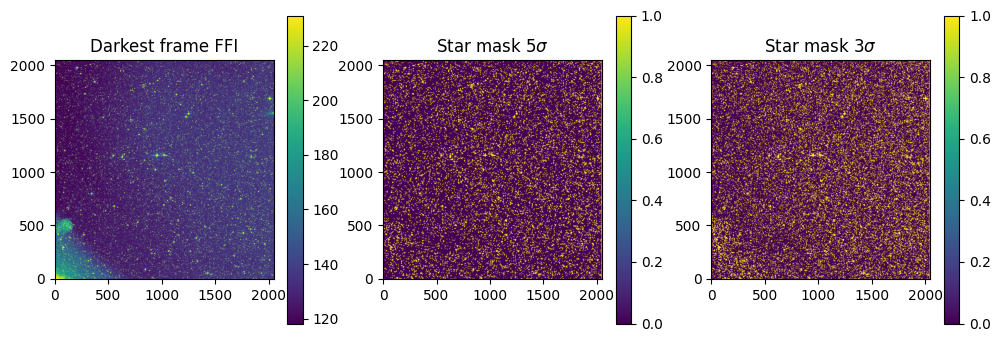

In [11]:
vmin, vmax = np.percentile(ffi_dark, [3,97])

fig, ax = plt.subplots(1,3,figsize=(12,4))
ax[0].set_title("Darkest frame FFI")
bar = ax[0].imshow(ffi_dark, origin="lower", vmin=vmin, vmax=vmax)
plt.colorbar(bar, ax=ax[0])
ax[1].set_title(r"Star mask 5$\sigma$")
bar = ax[1].imshow(star_mask5, origin="lower", vmin=0, vmax=1)
plt.colorbar(bar, ax=ax[1])
ax[2].set_title(r"Star mask 3$\sigma$")
bar = ax[2].imshow(star_mask3, origin="lower", vmin=0, vmax=1)
plt.colorbar(bar, ax=ax[2])
plt.show()

In [12]:
ffi_dark.shape

(2048, 2048)

In [13]:
ffidartk_med = pooling_2d(ffi_dark, kernel_size=16, stride=16, stat=np.nanmedian)
ffidartk_mean = pooling_2d_fast(ffi_dark, kernel_size=16, stride=16, stat=np.nanmean)

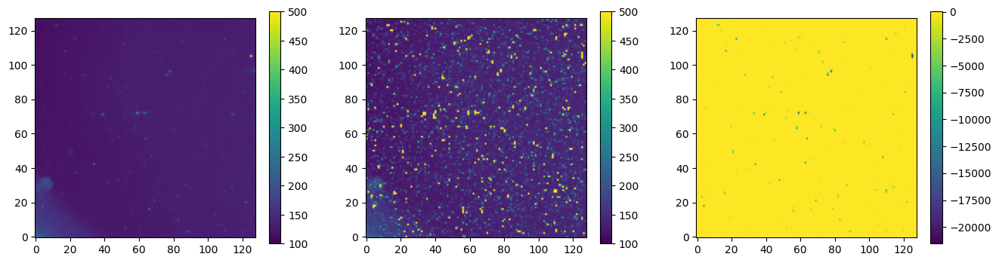

In [16]:
fig, ax = plt.subplots(1, 3, figsize=(16,4))

bar = ax[0].imshow(ffidartk_med, origin="lower", vmin=100, vmax=500)
plt.colorbar(bar, ax=ax[0])
bar = ax[1].imshow(ffidartk_mean, origin="lower", vmin=100, vmax=500)
plt.colorbar(bar, ax=ax[1])
bar = ax[2].imshow(ffidartk_med - ffidartk_mean, origin="lower")
plt.colorbar(bar, ax=ax[2])

plt.show()

In [39]:
if pix_grid == "sparse":
    srow = np.arange(rmin + 1 + step/2, rmax + 1 - step/2, step, dtype=int)
    scol = np.arange(cmin + step/2, cmax - step/2, step, dtype=int)
    
    srow_2d, scol_2d = np.meshgrid(srow, scol, indexing="ij")
    sparse_rc = [(r, c) for r, c in zip(srow_2d.ravel(), scol_2d.ravel())]
    flux_cube = tcube.get_pixel_timeseries(sparse_rc, return_errors=False)
    flux_cube = flux_cube.reshape((tcube.nframes, *srow_2d.shape))

elif pix_grid == "binning":
    srow = np.arange(rmin + 1, rmax + 1, step, dtype=int)
    scol = np.arange(cmin, cmax, step, dtype=int)
    srow_2d, scol_2d = np.meshgrid(srow, scol, indexing="ij")

    flux_cube = np.zeros((tcube.nframes, *srow_2d.shape), dtype=float)
    for i, r in tqdm(enumerate(srow), total=len(srow)):
        for j, c in enumerate(scol):
            aux, _ = tcube.get_flux((r, c), shape=(step, step))
            flux_cube[:, i, j] = np.nanmedian(aux.reshape((len(aux), -1)), axis=-1)
            # break
elif pix_grid == "per_frame":
    flux_cube = []
    for f in tqdm(range(tcube.nframes)):
        current = tcube.get_ffi(f)[1].data[rmin:rmax, cmin:cmax]
        current[star_mask5] = np.nan

        flux_cube.append(pooling_2d(current, kernel_size=step, stride=step, stat=np.nanmedian))
    flux_cube = np.array(flux_cube)

else:
    print("Wrong pixel grid option...")


100%|██████████| 1245/1245 [37:12<00:00,  1.79s/it]


In [69]:
tcube.cadence_number

In [70]:
flux_cube_tb

(622, 128, 128)

In [40]:
np.savez(f"./data/ffi_flux_cube_bin{step}_sector{sector:03}_{camera}-{ccd}_clippix_median.npz", 
        flux_cube=flux_cube,
)

# flux_cube = np.load(f"./data/ffi_cube_bin{step}_sector{sector:03}_{camera}-{ccd}_clippix_median.npz")["flux_cube"]

In [41]:
flux_cube.shape

(1245, 128, 128)

In [42]:
darkest_frame, dark_frames

(np.int64(32),
 array([17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
        51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
        68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79, 80]))

In [43]:
static = np.median(flux_cube[dark_frames], axis=0)
static.shape

(128, 128)

In [86]:
ani = animate_cube(
    flux_cube - static,
    scol_2d=None,
    srow_2d=None,
    plot_type= "img",
    extent=(cmin-0.5, cmax-0.5, rmin-0.5, rmax-0.5),
    interval=50,
    repeat_delay=500,
    step=4,
)

ani.save(f"./data/ffi_flux_cube_bin{step}_sector{sector:03}_{camera}-{ccd}_clippix_median.gif", writer="pillow")

HTML(ani.to_jshtml())

INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.PillowWriter'>
INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


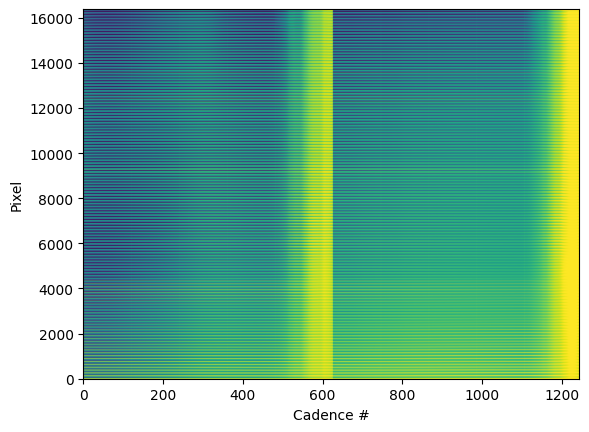

In [45]:
pixel_ts = flux_cube.reshape(flux_cube.shape[0], flux_cube.shape[1]*flux_cube.shape[2])
norm = simple_norm(pixel_ts.ravel(), "asinh", percent=92)

plt.imshow(pixel_ts.T, origin="lower", norm=norm, aspect="auto")
plt.ylabel("Pixel")
plt.xlabel("Cadence #")
plt.show()

# Tess Vectors

In [7]:
sector, camera, ccd

(2, 1, 3)

In [8]:
# vector = pd.read_csv(fileout, comment="#", index_col=False)
vector = tessvectors.getvector(("FFI", sector, camera))
vector

INFO:root:Retrieving TESSVector from: https://heasarc.gsfc.nasa.gov/docs/tess/data/TESSVectors/Vectors/FFI_Cadence/TessVectors_S002_C1_FFI.csv


,Cadence,MidTime,Segment,Quat_Start,Quat_Stop,Quat_MIN_FOM,Quat_MIN_NUM_GSUSED,Quat_NBinned,Quat1_Med,Quat1_StdDev,...,Earth_Camera_Angle,Earth_Camera_Azimuth,Moon_Distance,Moon_Camera_Angle,Moon_Camera_Azimuth,Earth_Spacecraft_Angle,Earth_Spacecraft_Azimuth,Moon_Spacecraft_Angle,Moon_Spacecraft_Azimuth,FFIFile
0,0.0,1354.115150,1.0,1354.104756,1354.125566,236.0,199.0,900.0,-1.763052e-06,2.446103e-06,...,129.079095,167.984036,56.385535,58.360192,91.387411,-3.652907,350.680590,25.881423,350.680590,tess2018235142941-s0002-1-{ccd}-0121-s_ffic.fits
1,1.0,1354.135983,1.0,1354.125589,1354.146399,236.0,199.0,900.0,-2.294218e-06,1.065047e-06,...,128.943041,166.040673,56.765745,58.478072,91.406059,-3.717936,349.162713,25.802507,349.162713,tess2018235145941-s0002-1-{ccd}-0121-s_ffic.fits
2,2.0,1354.156816,1.0,1354.146423,1354.167233,236.0,198.0,900.0,-2.341995e-06,7.060245e-07,...,128.778465,164.142947,57.146725,58.587385,91.414864,-3.779196,347.673967,25.724567,347.673967,tess2018235152941-s0002-1-{ccd}-0121-s_ffic.fits
3,3.0,1354.177650,1.0,1354.167256,1354.188066,236.0,198.0,900.0,-2.321651e-06,8.448943e-07,...,128.587444,162.291348,57.528145,58.688318,91.414320,-3.836811,346.213947,25.647739,346.213947,tess2018235155941-s0002-1-{ccd}-0121-s_ffic.fits
4,4.0,1354.198483,1.0,1354.188089,1354.208899,236.0,198.0,900.0,-2.259481e-06,9.254577e-07,...,128.371995,160.486111,57.909699,58.781065,91.404900,-3.890905,344.782215,25.572139,344.782215,tess2018235162941-s0002-1-{ccd}-0121-s_ffic.fits
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1240,1240.0,1381.406805,2.0,1381.396393,1381.417203,236.0,198.0,900.0,1.832905e-07,8.426202e-07,...,76.710138,279.695574,56.249626,32.376681,53.473229,5.142631,105.593338,29.730146,105.593338,tess2018262212940-s0002-1-{ccd}-0121-s_ffic.fits
1241,1241.0,1381.427639,2.0,1381.417226,1381.438036,236.0,199.0,900.0,2.314930e-07,1.153762e-06,...,77.640891,278.482223,55.894337,32.157302,53.925729,5.075613,104.083518,30.045875,104.083518,tess2018262215940-s0002-1-{ccd}-0121-s_ffic.fits
1242,1242.0,1381.448472,2.0,1381.438059,1381.458870,236.0,198.0,900.0,2.276983e-07,1.160789e-06,...,78.593462,277.256424,55.541832,31.944671,54.403947,5.003817,102.547518,30.363192,102.547518,tess2018262222940-s0002-1-{ccd}-0121-s_ffic.fits
1243,1243.0,1381.469305,2.0,1381.458893,1381.479703,236.0,199.0,900.0,5.322783e-08,1.538357e-06,...,79.567753,276.017776,55.192453,31.739391,54.908407,4.927101,100.985206,30.681866,100.985206,tess2018262225940-s0002-1-{ccd}-0121-s_ffic.fits


In [9]:
vector.columns

Index(['Cadence', 'MidTime', 'Segment', 'Quat_Start', 'Quat_Stop',
       'Quat_MIN_FOM', 'Quat_MIN_NUM_GSUSED', 'Quat_NBinned', 'Quat1_Med',
       'Quat1_StdDev', 'Quat1_StdDev_SigClip', 'Quat2_Med', 'Quat2_StdDev',
       'Quat2_StdDev_SigClip', 'Quat3_Med', 'Quat3_StdDev',
       'Quat3_StdDev_SigClip', 'Quat4_Med', 'Quat4_StdDev',
       'Quat4_StdDev_SigClip', 'Earth_Distance', 'Earth_Camera_Angle',
       'Earth_Camera_Azimuth', 'Moon_Distance', 'Moon_Camera_Angle',
       'Moon_Camera_Azimuth', 'Earth_Spacecraft_Angle',
       'Earth_Spacecraft_Azimuth', 'Moon_Spacecraft_Angle',
       'Moon_Spacecraft_Azimuth', 'FFIFile'],
      dtype='object')

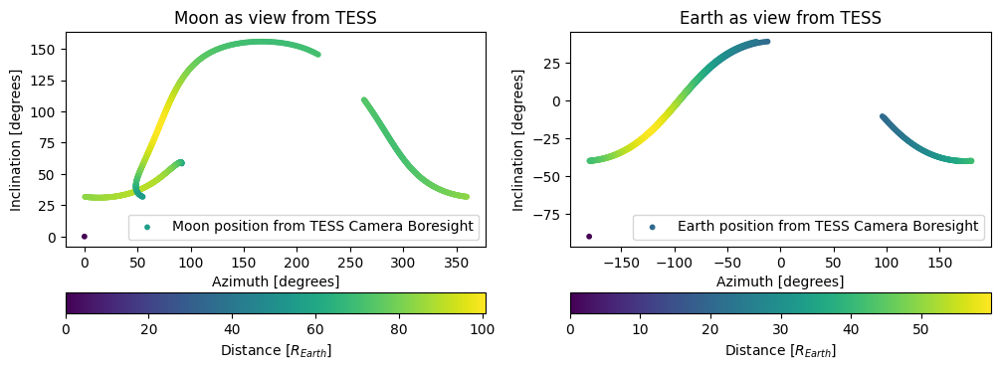

In [10]:
fig, ax = plt.subplots(1, 2, figsize=(12, 4))
im = ax[1].scatter(vector["Earth_Camera_Azimuth"]-180, vector["Earth_Camera_Angle"]-90, c=vector["Earth_Distance"], s=10, label='Earth position from TESS Camera Boresight')
cbar = plt.colorbar(im, ax=ax[1], orientation='horizontal')
cbar.set_label("Distance [$R_{Earth}$]")
ax[1].set(xlabel='Azimuth [degrees]', ylabel='Inclination [degrees]', title='Earth as view from TESS')
ax[1].legend()

im = ax[0].scatter(vector["Moon_Camera_Azimuth"], vector["Moon_Camera_Angle"], c=vector["Moon_Distance"], s=10, label='Moon position from TESS Camera Boresight')
cbar = plt.colorbar(im, ax=ax[0], orientation='horizontal')
cbar.set_label("Distance [$R_{Earth}$]")
ax[0].set(xlabel='Azimuth [degrees]', ylabel='Inclination [degrees]', title='Moon as view from TESS')
ax[0].legend()

plt.show()

NameError: name 'tcube' is not defined

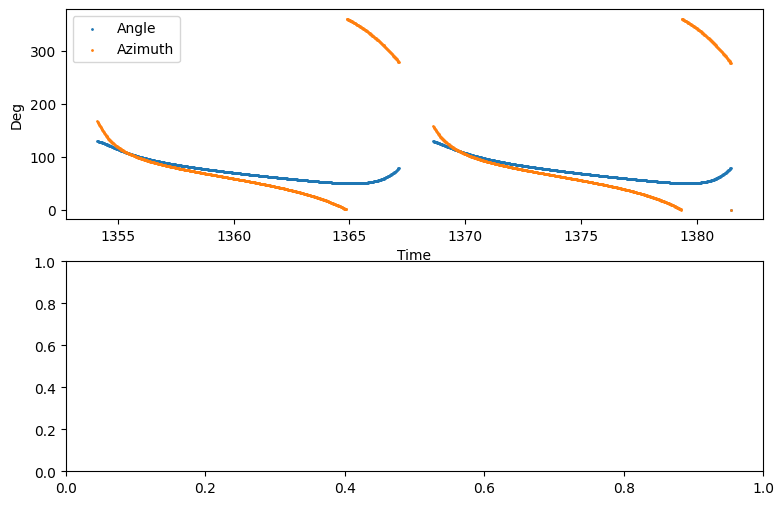

In [11]:
fig, ax = plt.subplots(2, 1, figsize=(9,6))
ax[0].scatter(vector["MidTime"], vector["Earth_Camera_Angle"], s=1, label="Angle")
ax[0].scatter(vector["MidTime"], vector["Earth_Camera_Azimuth"], s=1, label="Azimuth")
ax[0].set_xlabel("Time")
ax[0].set_ylabel("Deg")
ax[0].legend()

ax[1].scatter(tcube.time, np.nanmedian(pixel_ts, axis=1), s=1, label="bkg median")
ax[1].set_xlabel("Time")
ax[1].set_ylabel("Flux [-e/s]")
ax[1].legend()
plt.show()

# Angle Maps


In [12]:
import astropy.units as u
from astropy import constants as const
from tqdm import tqdm

In [13]:
camccd_orient = {
    "cam1": {1: "top left",
             2: "top left",
             3: "bottom right",
             4: "bottom right",
            },
    "cam2": {1: "top left",
             2: "top left",
             3: "bottom right",
             4: "bottom right",
            },
    "cam3": {1: "bottom right",
             2: "bottom right",
             3: "top left",
             4: "top left",
            },
    "cam4": {1: "bottom right",
             2: "bottom right",
             3: "top left",
             4: "top left",
            }
}

camccd_order = {
    "cam1": [1,2,4,3],
    "cam2": [1,2,4,3],
    "cam3": [3,4,2,1],
    "cam4": [3,4,2,1],
}


rmin = 0
rmax = 2048
cmin = 45
cmax = 2093

step = 16

tess_pscale = 0.21 * u.arcsec/u.pixel

In [57]:
earth_elev_map_ccd = {}
earth_az_map_ccd = {}
earth_dist_map_ccd = {}
earth_angs_map_ccd = {}

for ccd in range(1, 5):
    
    grid_row, grid_col = np.mgrid[rmin:rmax:step, cmin:cmax:step]
    
    grid_row_d = (grid_row * 15 * u.micrometer).to("m")
    grid_col_d = (grid_col * 15 * u.micrometer).to("m")

    if camera in [1, 2]:
        if ccd == 1:
            grid_col_d *= +1
            grid_row_d *= -1
        if ccd == 2:
            grid_col_d *= -1
            grid_row_d *= -1
        if ccd == 3:
            grid_col_d *= -1
            grid_row_d *= +1
        if ccd == 4:
            grid_row_d *= +1
            grid_col_d *= +1
    if camera in [3, 4]:
        if ccd == 3:
            grid_col_d *= +1
            grid_row_d *= -1
        if ccd == 4:
            grid_col_d *= -1
            grid_row_d *= -1
        if ccd == 1:
            grid_col_d *= -1
            grid_row_d *= +1
        if ccd == 2:
            grid_row_d *= +1
            grid_col_d *= +1

    _earth_elev_map = []
    _earth_az_map = []
    _earth_dist_map = []
    _earth_angs_map = []
    
    for t in tqdm(range(len(vector)), total=len(vector)): 
        dist = vector["Earth_Distance"][t] * const.R_earth
        aux_elev = np.sin(np.deg2rad(vector["Earth_Camera_Angle"][t] - 90)) + grid_row_d.to("m") / dist.to("m")
        aux_elev = np.rad2deg(np.arcsin(aux_elev)).value + 90
        _earth_elev_map.append(aux_elev)
        
        cos_ip = np.cos(np.deg2rad(aux_elev - 90))
        cos_i =  np.cos(np.deg2rad(vector["Earth_Camera_Angle"][t] - 90))
        sin_az =  np.cos(np.deg2rad(vector["Earth_Camera_Azimuth"][t] - 180))
        aux_az = (cos_i * sin_az) / (cos_ip) + (grid_col_d.to("m")) / (dist.to("m") * cos_ip)
        aux_az = np.rad2deg(np.arcsin(aux_az)).value + 180
        _earth_az_map.append(aux_az)

        ang_dist = (np.sqrt(grid_row ** 2 + grid_col ** 2) * u.pixel * tess_pscale)
        pix_dist = (np.sqrt(grid_row ** 2 + grid_col ** 2) * 15 * u.micrometer).to("m")
        aux_dist = dist.to("m") * np.cos(ang_dist.to("rad"))

        aux_dist += np.sqrt(pix_dist ** 2 + (dist.to("m") * np.sin(ang_dist.to("rad")))**2) * np.sign(grid_row_d)
        aux_dist[aux_dist.value < 1000] = 0
        _earth_dist_map.append(aux_dist)

        aux_angsize = 2 * np.arctan(const.R_earth.to("m") / (2 * aux_dist))
        aux_angsize = aux_angsize.to("deg").value
        aux_angsize[aux_angsize == 180] = 0
        _earth_angs_map.append(aux_angsize)
        # if t > 10: break

    if camera in [1, 2]:
        if ccd == 1:
            _earth_elev_map = np.flip(np.array(_earth_elev_map), axis=1)
            _earth_elev_map = np.flip(np.array(_earth_elev_map), axis=2)
            _earth_az_map = np.flip(np.array(_earth_az_map), axis=1)
            _earth_az_map = np.flip(np.array(_earth_az_map), axis=2)
            _earth_dist_map = np.flip(np.array(_earth_dist_map), axis=1)
            _earth_dist_map = np.flip(np.array(_earth_dist_map), axis=2)
            _earth_angs_map = np.flip(np.array(_earth_angs_map), axis=1)
            _earth_angs_map = np.flip(np.array(_earth_angs_map), axis=2)
        if ccd == 2:
            _earth_elev_map = np.flip(np.array(_earth_elev_map), axis=1)
            _earth_az_map = np.flip(np.array(_earth_az_map), axis=1)
            _earth_dist_map = np.flip(np.array(_earth_dist_map), axis=1)
            _earth_angs_map = np.flip(np.array(_earth_angs_map), axis=1)
        if ccd == 3:
            _earth_elev_map = np.flip(np.array(_earth_elev_map), axis=1)
            _earth_elev_map = np.flip(np.array(_earth_elev_map), axis=2)
            _earth_az_map = np.flip(np.array(_earth_az_map), axis=1)
            _earth_az_map = np.flip(np.array(_earth_az_map), axis=2)
            _earth_dist_map = np.flip(np.array(_earth_dist_map), axis=1)
            _earth_dist_map = np.flip(np.array(_earth_dist_map), axis=2)
            _earth_angs_map = np.flip(np.array(_earth_angs_map), axis=1)
            _earth_angs_map = np.flip(np.array(_earth_angs_map), axis=2)
        if ccd == 4:
            _earth_elev_map = np.flip(np.array(_earth_elev_map), axis=1)
            _earth_az_map = np.flip(np.array(_earth_az_map), axis=1)
            _earth_dist_map = np.flip(np.array(_earth_dist_map), axis=1)
            _earth_angs_map = np.flip(np.array(_earth_angs_map), axis=1)
    if camera in [3, 4]:
        if ccd == 3:
            _earth_elev_map = np.flip(np.array(_earth_elev_map), axis=1)
            _earth_elev_map = np.flip(np.array(_earth_elev_map), axis=2)
            _earth_az_map = np.flip(np.array(_earth_az_map), axis=1)
            _earth_az_map = np.flip(np.array(_earth_az_map), axis=2)
            _earth_dist_map = np.flip(np.array(_earth_dist_map), axis=1)
            _earth_dist_map = np.flip(np.array(_earth_dist_map), axis=2)
            _earth_angs_map = np.flip(np.array(_earth_angs_map), axis=1)
            _earth_angs_map = np.flip(np.array(_earth_angs_map), axis=2)
        if ccd == 4:
            _earth_elev_map = np.flip(np.array(_earth_elev_map), axis=1)
            _earth_az_map = np.flip(np.array(_earth_az_map), axis=1)
            _earth_dist_map = np.flip(np.array(_earth_dist_map), axis=1)
            _earth_angs_map = np.flip(np.array(_earth_angs_map), axis=1)
        if ccd == 1:
            _earth_elev_map = np.flip(np.array(_earth_elev_map), axis=1)
            _earth_elev_map = np.flip(np.array(_earth_elev_map), axis=2)
            _earth_az_map = np.flip(np.array(_earth_az_map), axis=1)
            _earth_az_map = np.flip(np.array(_earth_az_map), axis=2)
            _earth_dist_map = np.flip(np.array(_earth_dist_map), axis=1)
            _earth_dist_map = np.flip(np.array(_earth_dist_map), axis=2)
            _earth_angs_map = np.flip(np.array(_earth_angs_map), axis=1)
            _earth_angs_map = np.flip(np.array(_earth_angs_map), axis=2)
        if ccd == 2:
            _earth_elev_map = np.flip(np.array(_earth_elev_map), axis=1)
            _earth_az_map = np.flip(np.array(_earth_az_map), axis=1)
            _earth_dist_map = np.flip(np.array(_earth_dist_map), axis=1)
            _earth_angs_map = np.flip(np.array(_earth_angs_map), axis=1)
        
    earth_elev_map_ccd[ccd] = np.array(_earth_elev_map)
    earth_az_map_ccd[ccd] = np.array(_earth_az_map)
    earth_dist_map_ccd[ccd] = np.array(_earth_dist_map)
    earth_angs_map_ccd[ccd] = np.array(_earth_angs_map)

100%|██████████| 1245/1245 [00:02<00:00, 547.71it/s]


In [189]:
np.savez(f"./data/ffi_earth_cube_bin{step}_sector{sector:03}_{camera}-{ccd}.npz", 
        flux_cube=flux_cube,
        earth_elev_map_ccd=earth_elev_map_ccd[ccd],
        earth_az_map_ccd=earth_az_map_ccd[ccd],
        earth_dist_map_ccd=earth_dist_map_ccd[ccd],
)

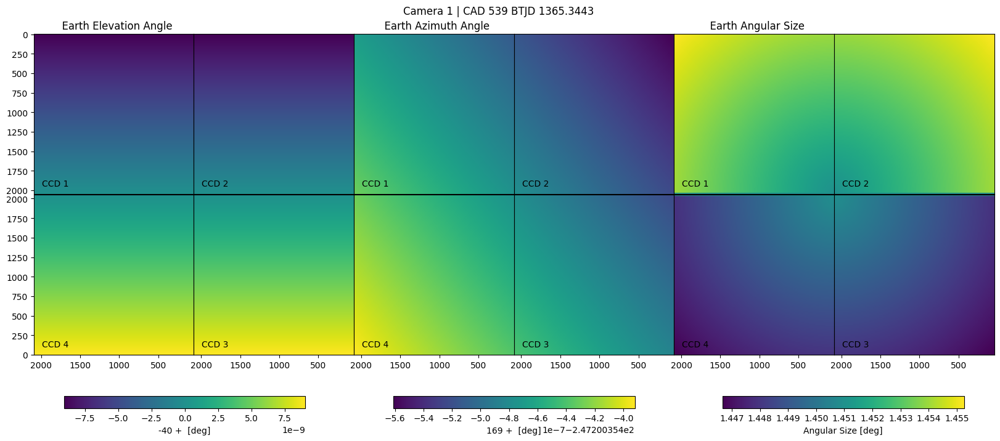

In [98]:
nt = 539

fig, ax = plt.subplots(2,6, figsize=(20.1,9), )

fig.suptitle(f"Camera {camera} | CAD {nt} BTJD {vector.MidTime[nt]:.4f}", y=0.93)
ax[0, 0].set_title(
    f"  Earth Elevation Angle"
)
ax[0, 2].set_title(
    f"  Earth Azimuth Angle"
)
ax[0, 4].set_title(
    f"  Earth Angular Size"
)

vmin = np.nanmin(np.array(list(earth_elev_map_ccd.values()))[:, nt]) - vector["Earth_Camera_Angle"].values[nt]
vmax = np.nanmax(np.array(list(earth_elev_map_ccd.values()))[:, nt]) - vector["Earth_Camera_Angle"].values[nt]
for k, axis in enumerate(ax[:, :2].ravel()):

    ccd_n = camccd_order[f'cam{camera}'][k]

    axis.annotate(f"CCD {ccd_n}", (0.05, 0.05), xycoords='axes fraction')
    bar = axis.imshow(earth_elev_map_ccd[ccd_n][nt] - vector["Earth_Camera_Angle"].values[nt],
                      origin="lower",
                      extent=(cmin-0.5, cmax-0.5, rmin-0.5, rmax-0.5),
                      vmin=vmin, vmax=vmax,
                     )
    if camccd_orient[f'cam{camera}'][ccd_n] == "top left":
        axis.invert_yaxis()
    if camccd_orient[f'cam{camera}'][ccd_n] == "bottom right":
        axis.invert_xaxis()

ax[0, 0].set_xticks([])
ax[0, 1].set_xticks([])
ax[0, 1].set_yticks([])
ax[1, 1].set_yticks([])

plt.colorbar(bar, ax=ax[:, :2], label=f"{vector['Earth_Camera_Angle'].values[nt]-90:.0f} +  [deg]", 
             location="bottom", shrink=0.8, pad=0.9)

vmin = np.nanmin(np.array(list(earth_az_map_ccd.values()))[:, nt]) - vector["Earth_Camera_Azimuth"].values[nt]
vmax = np.nanmax(np.array(list(earth_az_map_ccd.values()))[:, nt]) - vector["Earth_Camera_Azimuth"].values[nt]
for k, axis in enumerate(ax[:, 2:4].ravel()):

    ccd_n = camccd_order[f'cam{camera}'][k]
    axis.annotate(f"CCD {ccd_n}", (0.05, 0.05), xycoords='axes fraction')
    bar = axis.imshow(earth_az_map_ccd[ccd_n][nt] - vector["Earth_Camera_Azimuth"].values[nt],
                      origin="lower",
                      extent=(cmin-0.5, cmax-0.5, rmin-0.5, rmax-0.5),
                      vmin=vmin, vmax=vmax,
                     )
    if camccd_orient[f'cam{camera}'][ccd_n] == "top left":
        axis.invert_yaxis()
    if camccd_orient[f'cam{camera}'][ccd_n] == "bottom right":
        axis.invert_xaxis()

plt.colorbar(bar, ax=ax[:, 2:4], label=f"{vector['Earth_Camera_Azimuth'].values[nt]-180:.0f} +  [deg]", 
             location="bottom", shrink=0.8, pad=0.9)

ax[0, 2].set_xticks([])
ax[0, 2].set_yticks([])
ax[0, 3].set_xticks([])
ax[0, 3].set_yticks([])
ax[1, 2].set_yticks([])
ax[1, 3].set_yticks([])

# vmin = np.nanmin(np.array(list(earth_dist_map_ccd.values()))[:, nt]) / (vector["Earth_Distance"].values[nt] * (const.R_earth).value)
# vmax = np.nanmax(np.array(list(earth_dist_map_ccd.values()))[:, nt]) / (vector["Earth_Distance"].values[nt] * (const.R_earth).value)
vmin = np.nanmin(np.array(list(earth_angs_map_ccd.values()))[:, nt])
vmax = np.nanmax(np.array(list(earth_angs_map_ccd.values()))[:, nt])

for k, axis in enumerate(ax[:, 4:].ravel()):
    ccd_n = camccd_order[f'cam{camera}'][k]
    axis.annotate(f"CCD {ccd_n}", (0.05, 0.05), xycoords='axes fraction')
    bar = axis.imshow(earth_angs_map_ccd[ccd_n][nt],# / (vector["Earth_Distance"].values[nt] * (const.R_earth).value),
                      origin="lower",
                      extent=(cmin-0.5, cmax-0.5, rmin-0.5, rmax-0.5),
                      vmin=vmin, vmax=vmax,
                     )
    if camccd_orient[f'cam{camera}'][ccd_n] == "top left":
        axis.invert_yaxis()
    if camccd_orient[f'cam{camera}'][ccd_n] == "bottom right":
        axis.invert_xaxis()

plt.colorbar(bar, ax=ax[:, 4:], label=f"Angular Size [deg]", 
             location="bottom", shrink=0.8, pad=0.9)

ax[0, 4].set_xticks([])
ax[0, 4].set_yticks([])
ax[0, 5].set_xticks([])
ax[0, 5].set_yticks([])
ax[1, 4].set_yticks([])
ax[1, 5].set_yticks([])

plt.subplots_adjust(hspace=0., wspace=0., bottom=0.3)
plt.savefig("../data/figures/earth_vector_maps.png")

plt.show()

(array([  16384.,       0.,       0., 9624033., 4609115., 2311676.,
        1465417., 1061124.,  834272.,  476059.]),
 array([0.        , 0.27767775, 0.5553555 , 0.83303325, 1.110711  ,
        1.38838876, 1.66606651, 1.94374426, 2.22142201, 2.49909976,
        2.77677751]),
 <BarContainer object of 10 artists>)

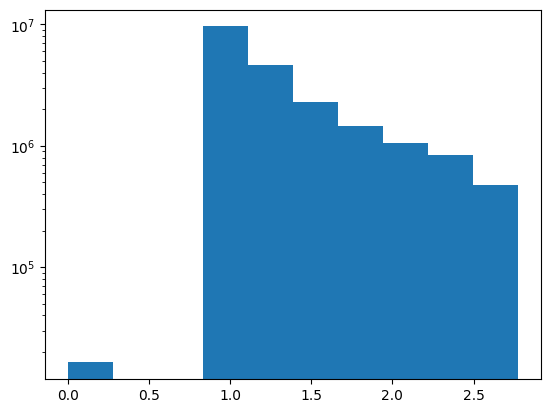

In [94]:
plt.hist(earth_angs_map_ccd[ccd_n].ravel(), log=True)

In [81]:
earth_angs_map_ccd[ccd_n].ravel().max()

2.776777510202624

In [75]:
x = np.array([1,2,3,4,5])
y = np.array([1,2,3,4,5]) * 2
z = np.array([1,2,3,4,5]) * 5


In [76]:
for var in [x, y, z]:
    var = np.mean(var)

In [78]:
var

np.float64(15.0)